In [2]:
library(ISLR)
library(MASS)

In [3]:
summary(Smarket)

      Year           Lag1                Lag2                Lag3          
 Min.   :2001   Min.   :-4.922000   Min.   :-4.922000   Min.   :-4.922000  
 1st Qu.:2002   1st Qu.:-0.639500   1st Qu.:-0.639500   1st Qu.:-0.640000  
 Median :2003   Median : 0.039000   Median : 0.039000   Median : 0.038500  
 Mean   :2003   Mean   : 0.003834   Mean   : 0.003919   Mean   : 0.001716  
 3rd Qu.:2004   3rd Qu.: 0.596750   3rd Qu.: 0.596750   3rd Qu.: 0.596750  
 Max.   :2005   Max.   : 5.733000   Max.   : 5.733000   Max.   : 5.733000  
      Lag4                Lag5              Volume           Today          
 Min.   :-4.922000   Min.   :-4.92200   Min.   :0.3561   Min.   :-4.922000  
 1st Qu.:-0.640000   1st Qu.:-0.64000   1st Qu.:1.2574   1st Qu.:-0.639500  
 Median : 0.038500   Median : 0.03850   Median :1.4229   Median : 0.038500  
 Mean   : 0.001636   Mean   : 0.00561   Mean   :1.4783   Mean   : 0.003138  
 3rd Qu.: 0.596750   3rd Qu.: 0.59700   3rd Qu.:1.6417   3rd Qu.: 0.596750  
 Max. 

In [4]:
attach(Smarket)

In [5]:
train=(Year <2005)
Smarket.2005= Smarket [! train ,]
Direction.2005=Direction[!train]

Call:
lda(Direction ~ Lag1 + Lag2, data = Smarket, subset = train)

Prior probabilities of groups:
    Down       Up 
0.491984 0.508016 

Group means:
            Lag1        Lag2
Down  0.04279022  0.03389409
Up   -0.03954635 -0.03132544

Coefficients of linear discriminants:
            LD1
Lag1 -0.6420190
Lag2 -0.5135293

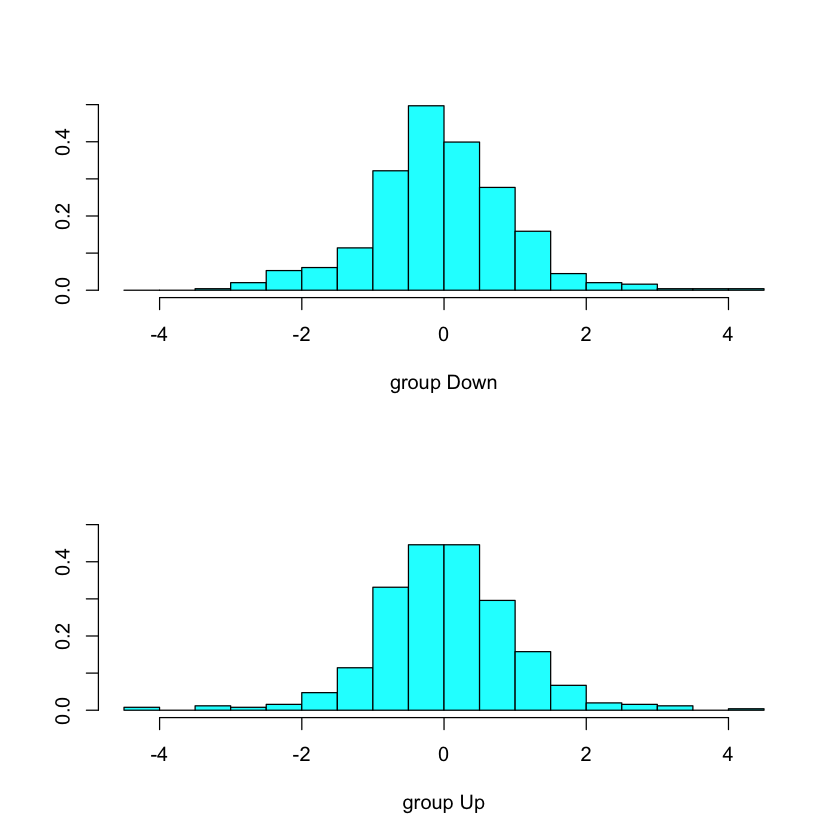

In [6]:
lda.fit=lda(Direction~Lag1+Lag2,data=Smarket,subset=train)
lda.fit
plot(lda.fit)

In [7]:
lda.pred=predict(lda.fit, Smarket.2005)
names(lda.pred)

[1] "class"     "posterior" "x"

In [8]:
lda.class=lda.pred$class

In [9]:
table(lda.class,Direction.2005)

         Direction.2005
lda.class Down  Up
     Down   35  35
     Up     76 106

In [10]:
mean(lda.class==Direction.2005)

[1] 0.5595238

In [11]:
lda.pred$posterior[1:20,1]
lda.class[1:20]

999      1000      1001      1002      1003      1004      1005      1006 
0.4901792 0.4792185 0.4668185 0.4740011 0.4927877 0.4938562 0.4951016 0.4872861 
     1007      1008      1009      1010      1011      1012      1013      1014 
0.4907013 0.4844026 0.4906963 0.5119988 0.4895152 0.4706761 0.4744593 0.4799583 
     1015      1016      1017      1018 
0.4935775 0.5030894 0.4978806 0.4886331

[1] Up   Up   Up   Up   Up   Up   Up   Up   Up   Up   Up   Down Up   Up   Up  
[16] Up   Up   Down Up   Up  
Levels: Down Up

In [12]:
min(lda.pred$posterior)

[1] 0.4577867

## QDA

In [13]:
qda.fit=qda(Direction~Lag1+Lag2,data=Smarket,subset=train)
qda.fit

Call:
qda(Direction ~ Lag1 + Lag2, data = Smarket, subset = train)

Prior probabilities of groups:
    Down       Up 
0.491984 0.508016 

Group means:
            Lag1        Lag2
Down  0.04279022  0.03389409
Up   -0.03954635 -0.03132544

In [14]:
qda.class=predict(qda.fit,Smarket.2005)$class
table(qda.class,Direction.2005)
mean(qda.class==Direction.2005)

         Direction.2005
qda.class Down  Up
     Down   30  20
     Up     81 121

[1] 0.5992063

## KNN 

In [15]:
library(class)
train.X=cbind(Lag1,Lag2)[train,]
test.X=cbind(Lag1,Lag2)[!train,]
train.Direction=Direction[train]

In [16]:
set.seed(1)
knn.pred=knn(train.X,test.X,train.Direction,k=1)
table(knn.pred,Direction.2005)

        Direction.2005
knn.pred Down Up
    Down   43 58
    Up     68 83

In [17]:
knn.pred=knn(train.X,test.X,train.Direction,k=3)
table(knn.pred,Direction.2005)

        Direction.2005
knn.pred Down Up
    Down   48 54
    Up     63 87

In [18]:
dim(Caravan)

[1] 5822   86

In [19]:
attach(Caravan)
summary(Caravan)

    MOSTYPE         MAANTHUI         MGEMOMV         MGEMLEEF    
 Min.   : 1.00   Min.   : 1.000   Min.   :1.000   Min.   :1.000  
 1st Qu.:10.00   1st Qu.: 1.000   1st Qu.:2.000   1st Qu.:2.000  
 Median :30.00   Median : 1.000   Median :3.000   Median :3.000  
 Mean   :24.25   Mean   : 1.111   Mean   :2.679   Mean   :2.991  
 3rd Qu.:35.00   3rd Qu.: 1.000   3rd Qu.:3.000   3rd Qu.:3.000  
 Max.   :41.00   Max.   :10.000   Max.   :5.000   Max.   :6.000  
    MOSHOOFD          MGODRK           MGODPR          MGODOV    
 Min.   : 1.000   Min.   :0.0000   Min.   :0.000   Min.   :0.00  
 1st Qu.: 3.000   1st Qu.:0.0000   1st Qu.:4.000   1st Qu.:0.00  
 Median : 7.000   Median :0.0000   Median :5.000   Median :1.00  
 Mean   : 5.774   Mean   :0.6965   Mean   :4.627   Mean   :1.07  
 3rd Qu.: 8.000   3rd Qu.:1.0000   3rd Qu.:6.000   3rd Qu.:2.00  
 Max.   :10.000   Max.   :9.0000   Max.   :9.000   Max.   :5.00  
     MGODGE          MRELGE          MRELSA           MRELOV    
 Min.   :0.

In [20]:
348/(348+5474)

[1] 0.05977327

In [21]:
standardized.X=scale(Caravan[,-86])

In [22]:
var(Caravan[,1])
var(standardized.X[,1])


[1] 165.0378

[1] 1

In [23]:
var(Caravan[,2])
var(standardized.X[,2])

[1] 0.1647078

[1] 1

In [24]:
test=1:1000
train.X=standardized.X[-test,]
test.X=standardized.X[test,]
train.Y=Purchase[-test]
test.Y=Purchase[test]
set.seed(1)
knn.pred=knn(train.X,test.X,train.Y,k=1)
table(knn.pred,test.Y)

        test.Y
knn.pred  No Yes
     No  873  50
     Yes  68   9

In [25]:
knn.pred=knn(train.X,test.X,train.Y,k=3)
table(knn.pred,test.Y)

        test.Y
knn.pred  No Yes
     No  920  54
     Yes  21   5

In [26]:
knn.pred=knn(train.X,test.X,train.Y,k=5)
table(knn.pred,test.Y)

        test.Y
knn.pred  No Yes
     No  930  55
     Yes  11   4

In [27]:
glm.fit=glm(Purchase~.,data=Caravan,family=binomial,subset=-test)
glm.prob=predict(glm.fit,Caravan[test,],type="response")
glm.pred=rep("No",1000)
glm.pred[glm.prob>0.25]="Yes"
table(glm.pred,test.Y)

Warning message:
: glm.fit: fitted probabilities numerically 0 or 1 occurred

        test.Y
glm.pred  No Yes
     No  919  48
     Yes  22  11

##Problem 10

In [28]:
library(ISLR)
summary(Weekly)

      Year           Lag1               Lag2               Lag3         
 Min.   :1990   Min.   :-18.1950   Min.   :-18.1950   Min.   :-18.1950  
 1st Qu.:1995   1st Qu.: -1.1540   1st Qu.: -1.1540   1st Qu.: -1.1580  
 Median :2000   Median :  0.2410   Median :  0.2410   Median :  0.2410  
 Mean   :2000   Mean   :  0.1506   Mean   :  0.1511   Mean   :  0.1472  
 3rd Qu.:2005   3rd Qu.:  1.4050   3rd Qu.:  1.4090   3rd Qu.:  1.4090  
 Max.   :2010   Max.   : 12.0260   Max.   : 12.0260   Max.   : 12.0260  
      Lag4               Lag5              Volume            Today         
 Min.   :-18.1950   Min.   :-18.1950   Min.   :0.08747   Min.   :-18.1950  
 1st Qu.: -1.1580   1st Qu.: -1.1660   1st Qu.:0.33202   1st Qu.: -1.1540  
 Median :  0.2380   Median :  0.2340   Median :1.00268   Median :  0.2410  
 Mean   :  0.1458   Mean   :  0.1399   Mean   :1.57462   Mean   :  0.1499  
 3rd Qu.:  1.4090   3rd Qu.:  1.4050   3rd Qu.:2.05373   3rd Qu.:  1.4050  
 Max.   : 12.0260   Max.   : 12.0

In [29]:
cor(Weekly[,-9])

,Year,Lag1,Lag2,Lag3,Lag4,Lag5,Volume,Today
Year,1.00000000,-0.03228927,-0.03339001,-0.03000649,-0.03112792,-0.03051910,0.84194162,-0.03245989
Lag1,-0.032289274,1.000000000,-0.074853051,0.058635682,-0.071273876,-0.008183096,-0.064951313,-0.075031842
Lag2,-0.03339001,-0.07485305,1.00000000,-0.07572091,0.05838153,-0.07249948,-0.08551314,0.05916672
Lag3,-0.03000649,0.05863568,-0.07572091,1.00000000,-0.07539587,0.06065717,-0.06928771,-0.07124364
Lag4,-0.031127923,-0.071273876,0.058381535,-0.075395865,1.000000000,-0.075675027,-0.061074617,-0.007825873
Lag5,-0.030519101,-0.008183096,-0.072499482,0.060657175,-0.075675027,1.000000000,-0.058517414,0.011012698
Volume,0.84194162,-0.06495131,-0.08551314,-0.06928771,-0.06107462,-0.05851741,1.00000000,-0.03307778
Today,-0.032459894,-0.075031842,0.059166717,-0.071243639,-0.007825873,0.011012698,-0.033077783,1.000000000


In [29]:
attach(Weekly)

The following objects are masked from Smarket:

    Direction, Lag1, Lag2, Lag3, Lag4, Lag5, Today, Volume, Year



In [30]:
glm.fit=glm(Direction~Lag1+Lag2+Lag3+Lag4+Lag5+Volume,family="binomial",data=Weekly)
summary(glm.fit)


Call:
glm(formula = Direction ~ Lag1 + Lag2 + Lag3 + Lag4 + Lag5 + 
    Volume, family = "binomial", data = Weekly)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.6949  -1.2565   0.9913   1.0849   1.4579  

Coefficients:
            Estimate Std. Error z value Pr(>|z|)   
(Intercept)  0.26686    0.08593   3.106   0.0019 **
Lag1        -0.04127    0.02641  -1.563   0.1181   
Lag2         0.05844    0.02686   2.175   0.0296 * 
Lag3        -0.01606    0.02666  -0.602   0.5469   
Lag4        -0.02779    0.02646  -1.050   0.2937   
Lag5        -0.01447    0.02638  -0.549   0.5833   
Volume      -0.02274    0.03690  -0.616   0.5377   
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

(Dispersion parameter for binomial family taken to be 1)

    Null deviance: 1496.2  on 1088  degrees of freedom
Residual deviance: 1486.4  on 1082  degrees of freedom
AIC: 1500.4

Number of Fisher Scoring iterations: 4


In [31]:
glm.probs=predict(glm.fit,type="response")
glm.pred=rep("Down",nrow(Weekly))
glm.pred[glm.probs>0.5]="Up"
table(glm.pred,Direction)

        Direction
glm.pred Down  Up
    Down   54  48
    Up    430 557

In [32]:
mean(glm.pred==Direction)

[1] 0.5610652

In [33]:
557/(430+557)

[1] 0.5643364

In [34]:
train=(Year<2009)
test=Weekly[!train,]
glm.fit=glm(Direction~Lag2,family="binomial",data=Weekly,subset=train)
glm.probs=predict(glm.fit,test,type="response")
glm.pred=rep("Down",nrow(test))
glm.pred[glm.probs>0.5]="Up"
table(glm.pred,test$Direction)

        
glm.pred Down Up
    Down    9  5
    Up     34 56

In [35]:
mean(glm.pred==test$Direction)
56/90

[1] 0.625

[1] 0.6222222

In [36]:
library(MASS)
lda.fit=lda(Direction~Lag2,data=Weekly,subset=train)
lda.pred=predict(lda.fit,test)
table(lda.pred$class,test$Direction)
lda.fit

      
       Down Up
  Down    9  5
  Up     34 56

Call:
lda(Direction ~ Lag2, data = Weekly, subset = train)

Prior probabilities of groups:
     Down        Up 
0.4477157 0.5522843 

Group means:
            Lag2
Down -0.03568254
Up    0.26036581

Coefficients of linear discriminants:
           LD1
Lag2 0.4414162

In [37]:
qda.fit=qda(Direction~Lag2,data=Weekly,subset=train)
qda.pred=predict(qda.fit,test)
table(qda.pred$class,test$Direction)

      
       Down Up
  Down    0  0
  Up     43 61

In [38]:
library(class)
train.X=as.matrix(Lag2[train])
train.Y=Direction[train]
test.X=as.matrix(Lag2[!train])
test.Y=Direction[!train]
set.seed(1)
knn.pred=knn(train.X,test.X,train.Y,k=1)
table(knn.pred,test.Y)

        test.Y
knn.pred Down Up
    Down   21 30
    Up     22 31

In [39]:
mean(knn.pred==test.Y)

[1] 0.5

##Problem 11

In [41]:
library(ISLR)
summary(Auto)

      mpg          cylinders      displacement     horsepower        weight    
 Min.   : 9.00   Min.   :3.000   Min.   : 68.0   Min.   : 46.0   Min.   :1613  
 1st Qu.:17.00   1st Qu.:4.000   1st Qu.:105.0   1st Qu.: 75.0   1st Qu.:2225  
 Median :22.75   Median :4.000   Median :151.0   Median : 93.5   Median :2804  
 Mean   :23.45   Mean   :5.472   Mean   :194.4   Mean   :104.5   Mean   :2978  
 3rd Qu.:29.00   3rd Qu.:8.000   3rd Qu.:275.8   3rd Qu.:126.0   3rd Qu.:3615  
 Max.   :46.60   Max.   :8.000   Max.   :455.0   Max.   :230.0   Max.   :5140  
                                                                               
  acceleration        year           origin                      name    
 Min.   : 8.00   Min.   :70.00   Min.   :1.000   amc matador       :  5  
 1st Qu.:13.78   1st Qu.:73.00   1st Qu.:1.000   ford pinto        :  5  
 Median :15.50   Median :76.00   Median :1.000   toyota corolla    :  5  
 Mean   :15.54   Mean   :75.98   Mean   :1.577   amc gremlin    

The following object is masked _by_ .GlobalEnv:

    mpg01

The following objects are masked from Auto (pos = 3):

    acceleration, cylinders, displacement, horsepower, mpg, mpg01,
    name, origin, weight, year

The following objects are masked from Auto (pos = 4):

    acceleration, cylinders, displacement, horsepower, mpg, name,
    origin, weight, year



      mpg          cylinders      displacement     horsepower        weight    
 Min.   : 9.00   Min.   :3.000   Min.   : 68.0   Min.   : 46.0   Min.   :1613  
 1st Qu.:17.00   1st Qu.:4.000   1st Qu.:105.0   1st Qu.: 75.0   1st Qu.:2225  
 Median :22.75   Median :4.000   Median :151.0   Median : 93.5   Median :2804  
 Mean   :23.45   Mean   :5.472   Mean   :194.4   Mean   :104.5   Mean   :2978  
 3rd Qu.:29.00   3rd Qu.:8.000   3rd Qu.:275.8   3rd Qu.:126.0   3rd Qu.:3615  
 Max.   :46.60   Max.   :8.000   Max.   :455.0   Max.   :230.0   Max.   :5140  
                                                                               
  acceleration        year           origin                      name    
 Min.   : 8.00   Min.   :70.00   Min.   :1.000   amc matador       :  5  
 1st Qu.:13.78   1st Qu.:73.00   1st Qu.:1.000   ford pinto        :  5  
 Median :15.50   Median :76.00   Median :1.000   toyota corolla    :  5  
 Mean   :15.54   Mean   :75.98   Mean   :1.577   amc gremlin    

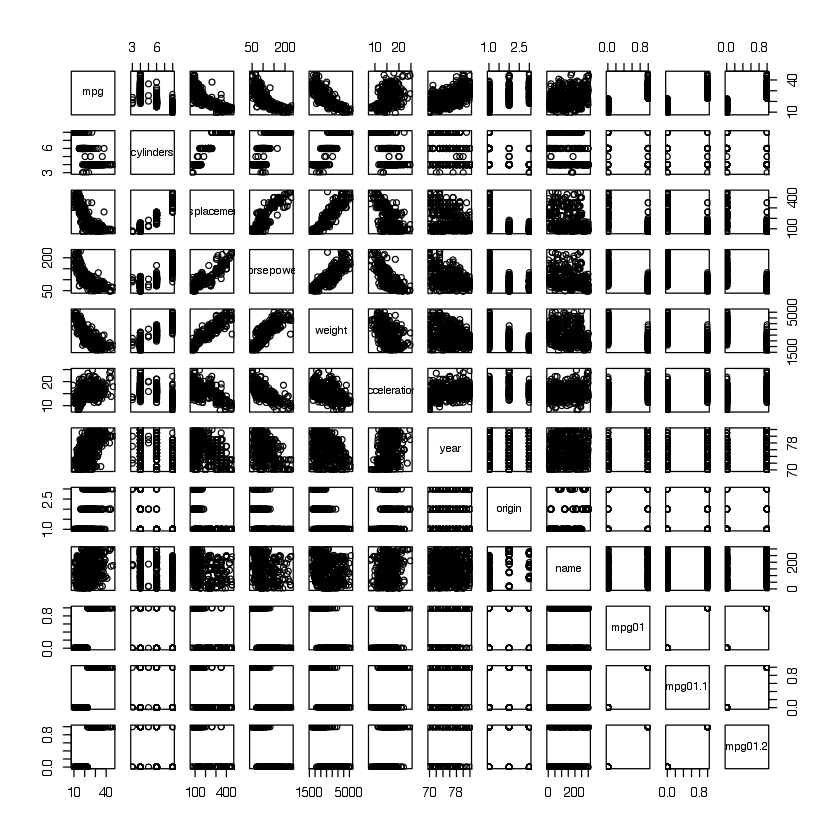

In [49]:
library(ISLR)
attach(Auto)
mpg01=rep(0,nrow(Auto))
mpg01[mpg>median(mpg)]=1
Auto=data.frame(Auto,mpg01)
summary(Auto)
pairs(Auto)

In [50]:
train=(year%%2==0)
Auto.train=Auto[train,]
Auto.test=Auto[!train,]

In [51]:
#LDA
library(MASS)
lda.fit=lda(mpg01~cylinders+weight+displacement+horsepower,data=Auto,subset=train)
lda.pred=predict(lda.fit,Auto.test)
table(lda.pred$class,Auto.test$mpg01)
mean(lda.pred$class!=Auto.test$mpg01)

   
     0  1
  0 86  9
  1 14 73

[1] 0.1263736

In [52]:
#QDA
qda.fit=qda(mpg01~cylinders+weight+displacement+horsepower,data=Auto,subset=train)
qda.pred=predict(qda.fit,Auto.test)
table(qda.pred$class,Auto.test$mpg01)
mean(qda.pred$class!=Auto.test$mpg01)

   
     0  1
  0 89 13
  1 11 69

[1] 0.1318681

In [53]:
#Logistic
glm.fit=glm(mpg01~cylinders+weight+displacement+horsepower,data=Auto,subset=train,family=binomial)
glm.probs=predict(glm.fit,Auto.test,type="response")
glm.pred=rep(0,length(glm.probs))
glm.pred[glm.probs>0.5]=1
mean(glm.pred!=Auto.test$mpg01)

[1] 0.1208791

##Problem 12

In [59]:
Power=function(){
    print(2^3)
}
Power2=function(x,y){
    print(x^y)
}
Power3=function(x,y){
    return(x^y)
}

In [57]:
Power2(10,3)
Power2(8,17)
Power2(131,3)

[1] 1000
[1] 2.2518e+15
[1] 2248091


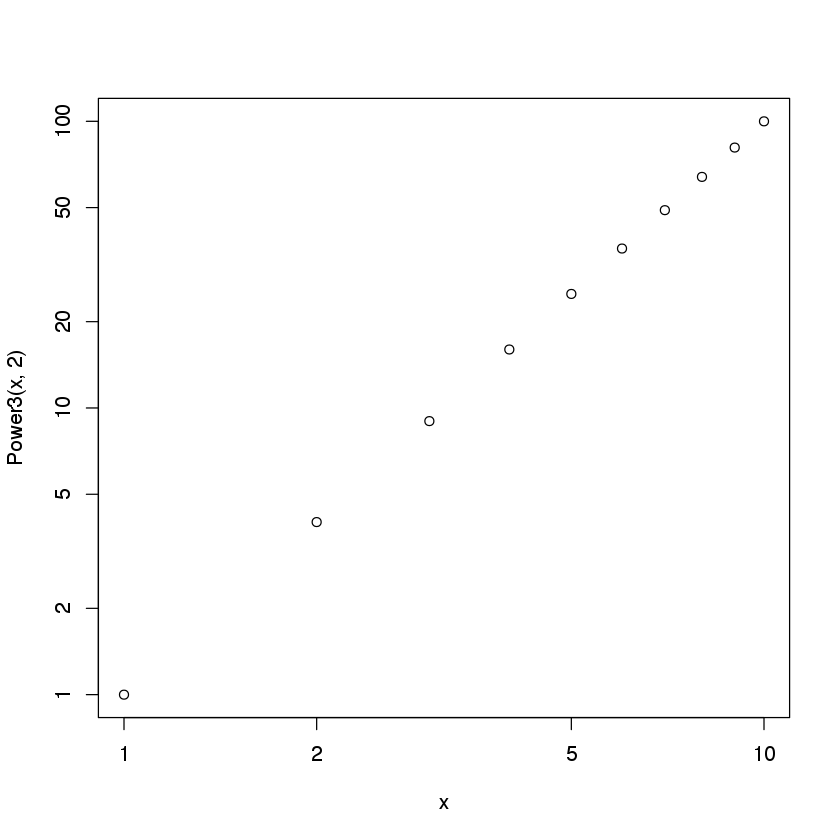

In [62]:
x=1:10
plot(x,Power3(x,2),log="xy")